# Permanent magnet assembly B-field simulation

## 3 rings (quasi Maxwell coil) optimization

Nelder-Mead

In [2]:
from maggeometry import three_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
# innerrad1, innerrad2, width, thickness, dist1, dist2
# x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def max_nonuniformity(x):
    innerrad1, innerrad2, width, thickness, dist = x
    magnets = three_rings(Br, innerrad1, innerrad2, width, thickness, dist)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity

# innerrad1, innerrad2, width, thickness, dist
bounds = Bounds([1, 1, 2, 2, 1], [150, 150, 10, 20, 300])
x0 = [80, 100, 5, 2.4, 200]
options = {'disp':True, 'fatol': 1e-17}
# options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.019580
         Iterations: 58
         Function evaluations: 86
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 0.01957967965115069
             x: [ 1.500e+02  1.000e+00  1.000e+01  2.000e+00  3.000e+02]
           nit: 58
          nfev: 86
 final_simplex: (array([[ 1.500e+02,  1.000e+00, ...,  2.000e+00,
                         3.000e+02],
                       [ 1.500e+02,  1.000e+00, ...,  2.000e+00,
                         3.000e+02],
                       ...,
                       [ 1.500e+02,  1.000e+00, ...,  2.000e+00,
                         3.000e+02],
                       [ 1.500e+02,  1.000e+00, ...,  2.000e+00,
                         3.000e+02]]), array([ 1.958e-02,  1.958e-02,  1.958e-02,  1.958e-02,
                        1.958e-02,  1.958e-02]))


On x-axis:
Maximum B-field: -4.445 G
Central B-field: -4.445 G
Min nonuniformity: 0.0
Max nonuniformity:0.009726300331590998


On y-axis:
Maximum B-field: -4.445 G
Central B-field: -4.445 G
Min nonuniformity: 0.0
Max nonuniformity:0.009726300331590998


On z-axis:
Maximum B-field: -4.36 G
Central B-field: -4.445 G
Min nonuniformity: 0.0
Max nonuniformity:0.019161558623139608




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:152: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[3].set_ylim(x_min_nonuniformity - 1e-7, x_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:157: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[4].set_ylim(y_min_nonuniformity - 1e-7, y_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:162: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[5].set_ylim(z_min_nonuniformity - 1e-7, z_max_nonuniformity + 1e-7)


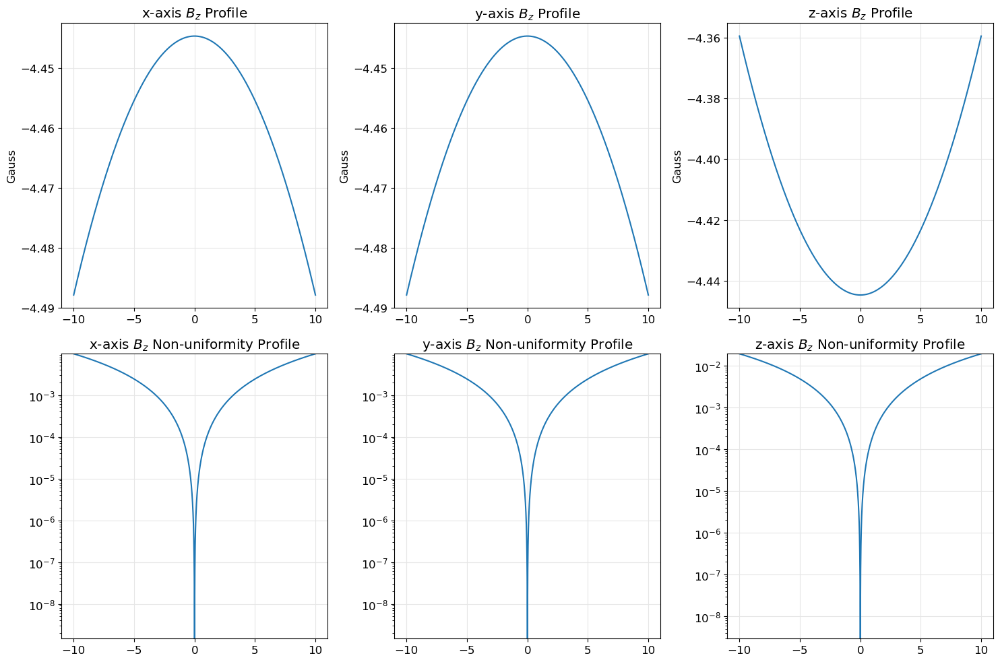

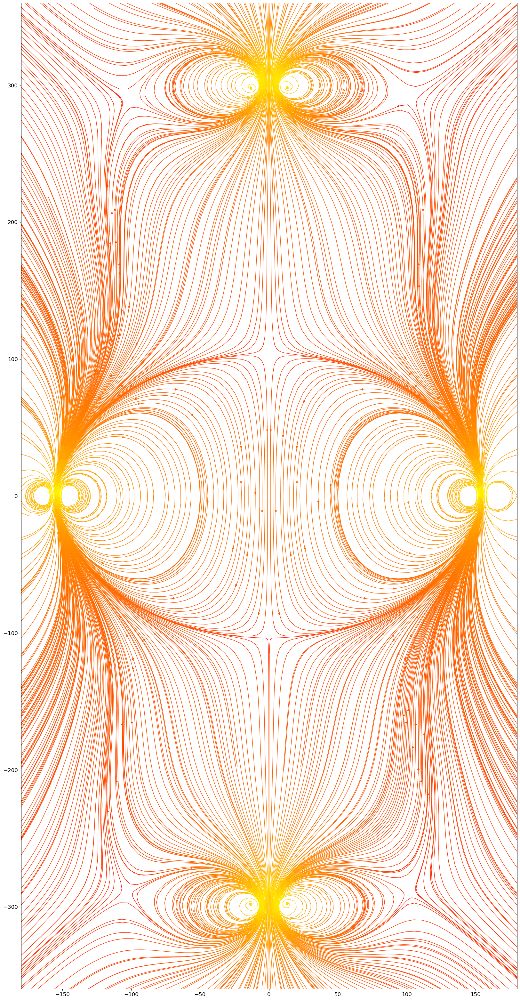

In [3]:
from maggeometry import three_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad1, innerrad2, width, thickness, dist = res.x
Br = 1.09e3
magnets = three_rings(Br, innerrad1, innerrad2, width, thickness, dist)

sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad1, 1.2*innerrad1]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

In [7]:
bounds = Bounds([1, 1, 2, 2, 1], [150, 150, 10, 5, 300])
x0 = [100, 40, 5, 2.4, 200]
options = {'disp':True, 'fatol': 1e-17}
# options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.019568
         Iterations: 44
         Function evaluations: 67
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 0.019568358484956177
             x: [ 1.500e+02  1.000e+00  1.000e+01  5.000e+00  3.000e+02]
           nit: 44
          nfev: 67
 final_simplex: (array([[ 1.500e+02,  1.000e+00, ...,  5.000e+00,
                         3.000e+02],
                       [ 1.500e+02,  1.000e+00, ...,  5.000e+00,
                         3.000e+02],
                       ...,
                       [ 1.500e+02,  1.000e+00, ...,  5.000e+00,
                         3.000e+02],
                       [ 1.500e+02,  1.000e+00, ...,  5.000e+00,
                         3.000e+02]]), array([ 1.957e-02,  1.957e-02,  1.957e-02,  1.957e-02,
                        1.957e-02,  1.957e-02]))


Powell

notes:
- finds a good nonuniformity value
- the field points opposite the expected axis direction!

powell x powell leads to worse result
powell x nelder-mead does not converge within iteration limit, but improves by 3-fold
nelder-mead right off the bat leads to pretty bad results.

In [1]:
from maggeometry import three_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
bounds = Bounds([1, 1, 2, 2, 1], [150, 150, 10, 5, 300])
x0 = [100, 40, 5, 2.4, 200]
options = {'disp':True}
method = "Powell"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

NameError: name 'max_nonuniformity' is not defined

On x-axis:
Maximum B-field: -14.672 G
Central B-field: -14.672 G
Min nonuniformity: 0.0
Max nonuniformity:1.5139801104111694e-05


On y-axis:
Maximum B-field: -14.672 G
Central B-field: -14.672 G
Min nonuniformity: 0.0
Max nonuniformity:1.5139801104111694e-05


On z-axis:
Maximum B-field: -14.672 G
Central B-field: -14.672 G
Min nonuniformity: 0.0
Max nonuniformity:7.479997802201517e-05




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:152: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:157: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:162: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.



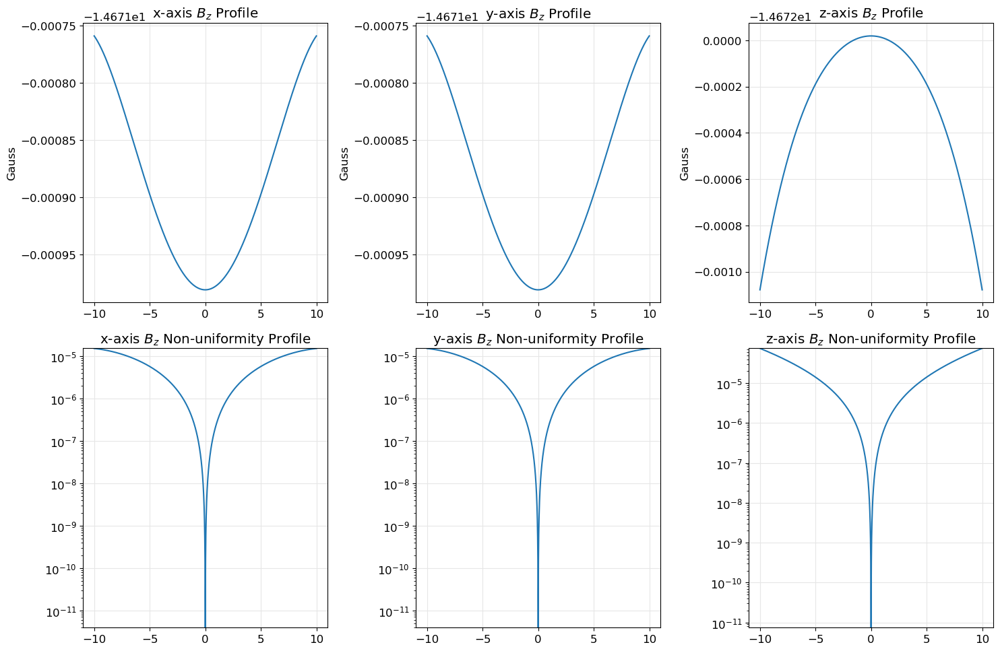

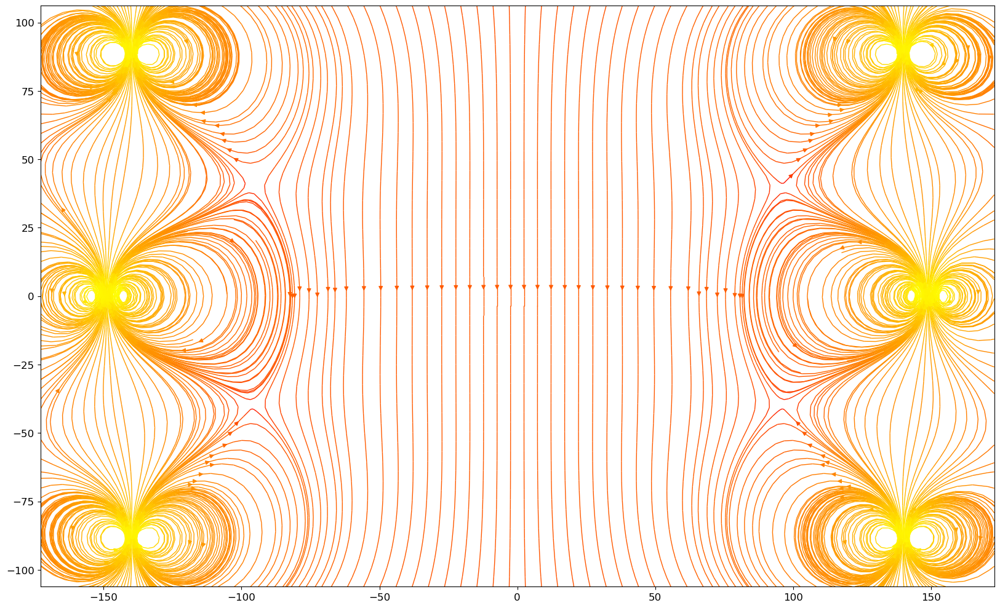

In [6]:
from maggeometry import three_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
x = [ 1.441e+02,  1.350e+02,  1.000e+01,  4.996e+00,  8.842e+01]
# innerrad1, innerrad2, width, thickness, dist = res.x
Br = 1.09e3
innerrad1, innerrad2, width, thickness, dist = x
magnets = three_rings(Br, innerrad1, innerrad2, width, thickness, dist)

sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad1, 1.2*innerrad1]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

In [13]:
from maggeometry import three_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
bounds = Bounds([5, 50, 8, 2, 1], [175, 175, 15, 5, 100])
x0 = [ 1.441e+02,  1.350e+02,  1.000e+01,  4.996e+00,  8.842e+01]
options = {'disp':True}
method = "nelder-mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

       message: Maximum number of function evaluations has been exceeded.
       success: False
        status: 1
           fun: 2.144917448247285e-06
             x: [ 1.370e+02  1.281e+02  8.023e+00  4.685e+00  8.007e+01]
           nit: 614
          nfev: 1000
 final_simplex: (array([[ 1.370e+02,  1.281e+02, ...,  4.685e+00,
                         8.007e+01],
                       [ 1.369e+02,  1.281e+02, ...,  4.684e+00,
                         8.004e+01],
                       ...,
                       [ 1.369e+02,  1.280e+02, ...,  4.683e+00,
                         8.000e+01],
                       [ 1.370e+02,  1.282e+02, ...,  4.685e+00,
                         8.008e+01]]), array([ 2.145e-06,  2.150e-06,  2.152e-06,  2.161e-06,
                        2.166e-06,  2.168e-06]))


/var/folders/06/7pjfbw510cz2ch1m7lx8vvl80000gn/T/ipykernel_63302/1427565295.py:8: RuntimeWarning:

Maximum number of function evaluations has been exceeded.



On x-axis:
Maximum B-field: -13.149 G
Central B-field: -13.149 G
Min nonuniformity: 0.0
Max nonuniformity:2.0428071965556112e-05


On y-axis:
Maximum B-field: -13.149 G
Central B-field: -13.149 G
Min nonuniformity: 0.0
Max nonuniformity:2.0428071965556112e-05


On z-axis:
Maximum B-field: -13.149 G
Central B-field: -13.149 G
Min nonuniformity: 0.0
Max nonuniformity:4.8054240796879755e-05




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:152: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[3].set_ylim(x_min_nonuniformity - 1e-7, x_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:157: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[4].set_ylim(y_min_nonuniformity - 1e-7, y_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:162: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[5].set_ylim(z_min_nonuniformity - 1e-7, z_max_nonuniformity + 1e-7)


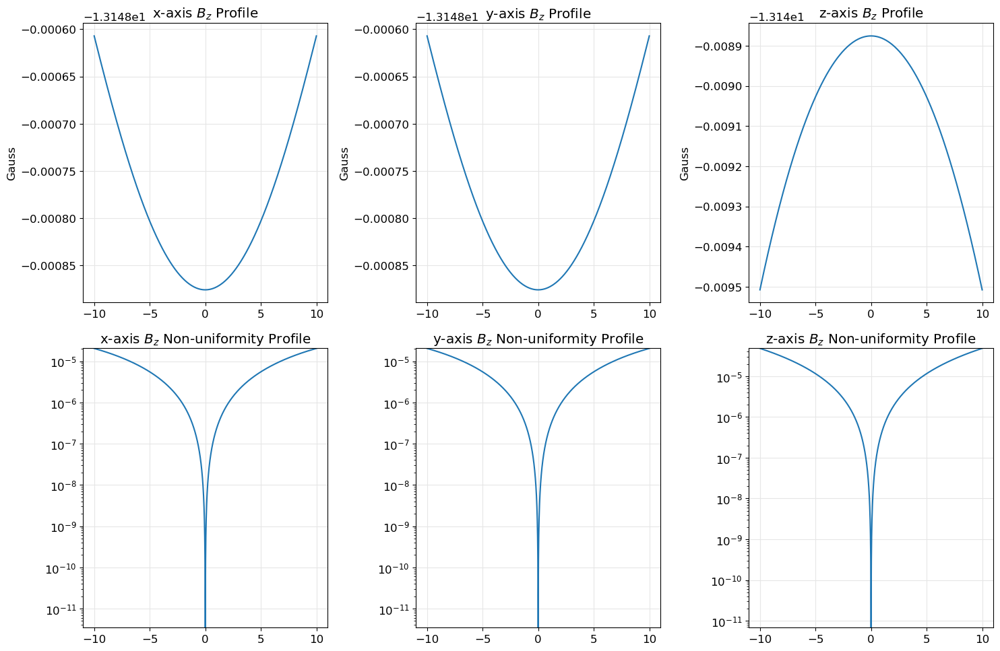

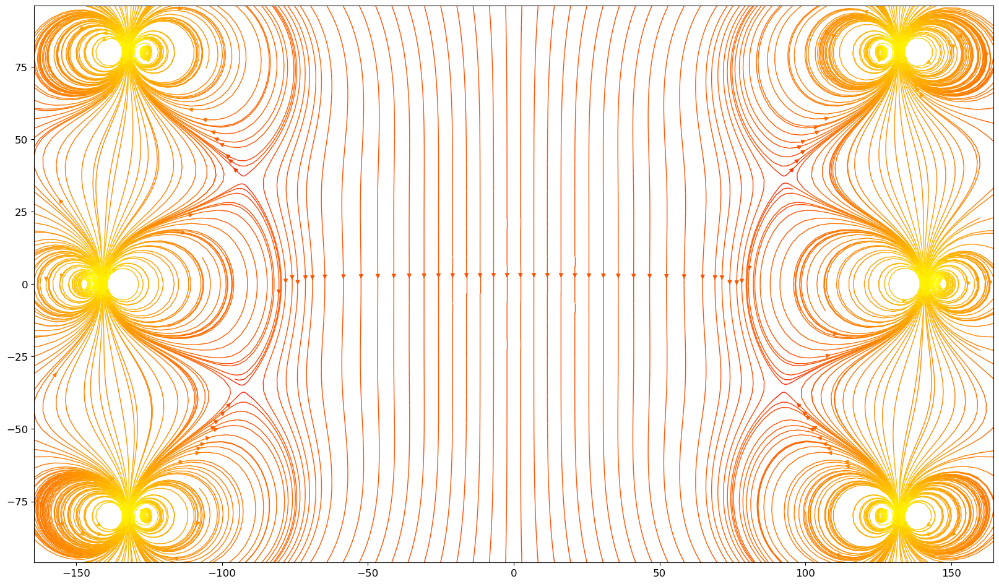

In [2]:
from maggeometry import three_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
x = [ 1.370e+02,  1.281e+02,  8.023e+00,  4.685e+00,  8.007e+01]
# innerrad1, innerrad2, width, thickness, dist = res.x
Br = 1.09e3
innerrad1, innerrad2, width, thickness, dist = x
magnets = three_rings(Br, innerrad1, innerrad2, width, thickness, dist)

sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad1, 1.2*innerrad1]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

Scratch

In [2]:
from maggeometry import three_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def max_nonuniformity(x):
    innerrad1, innerrad2, width, thickness, dist = x
    magnets = three_rings(Br, innerrad1, innerrad2, width, thickness, dist)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity

bounds = Bounds([1, 1, 2, 2, 1], [150, 150, 10, 5, 300])
x0 = [100, 40, 5, 2.4, 200]
options = {'disp':True}
method = "Powell"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000007
         Iterations: 5
         Function evaluations: 680
 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 7.402291740424132e-06
       x: [ 1.441e+02  1.350e+02  1.000e+01  4.996e+00  8.842e+01]
     nit: 5
   direc: [[-5.822e+00  8.231e+01 ...  3.265e-08  1.837e-05]
           [ 0.000e+00  0.000e+00 ...  0.000e+00  1.000e+00]
           ...
           [ 0.000e+00  0.000e+00 ...  1.000e+00  0.000e+00]
           [-6.056e-02 -5.457e-02 ... -3.685e-03  2.831e-02]]
    nfev: 680


In [3]:
from maggeometry import three_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
bounds = Bounds([5, 50, 8, 2, 1], [175, 175, 15, 5, 100])
x0 = [ 1.441e+02,  1.350e+02,  1.000e+01,  4.996e+00,  8.842e+01]
options = {'disp':True}
method = "nelder-mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

       message: Maximum number of function evaluations has been exceeded.
       success: False
        status: 1
           fun: 2.144917448247285e-06
             x: [ 1.370e+02  1.281e+02  8.023e+00  4.685e+00  8.007e+01]
           nit: 614
          nfev: 1000
 final_simplex: (array([[ 1.370e+02,  1.281e+02, ...,  4.685e+00,
                         8.007e+01],
                       [ 1.369e+02,  1.281e+02, ...,  4.684e+00,
                         8.004e+01],
                       ...,
                       [ 1.369e+02,  1.280e+02, ...,  4.683e+00,
                         8.000e+01],
                       [ 1.370e+02,  1.282e+02, ...,  4.685e+00,
                         8.008e+01]]), array([ 2.145e-06,  2.150e-06,  2.152e-06,  2.161e-06,
                        2.166e-06,  2.168e-06]))


/var/folders/06/7pjfbw510cz2ch1m7lx8vvl80000gn/T/ipykernel_49162/1427565295.py:8: RuntimeWarning: Maximum number of function evaluations has been exceeded.
  res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)


In [4]:
print(res.x)

[136.97475139 128.14006821   8.02343234   4.68496629  80.07094573]


On x-axis:
Maximum B-field: -13.157 G
Central B-field: -13.157 G
Min nonuniformity: 0.0
Max nonuniformity:2.1353713926698382e-06


On y-axis:
Maximum B-field: -13.157 G
Central B-field: -13.157 G
Min nonuniformity: 0.0
Max nonuniformity:2.1353713926698382e-06


On z-axis:
Maximum B-field: -13.157 G
Central B-field: -13.157 G
Min nonuniformity: 0.0
Max nonuniformity:1.2054969801009249e-05




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:152: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[3].set_ylim(x_min_nonuniformity - 1e-7, x_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:157: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[4].set_ylim(y_min_nonuniformity - 1e-7, y_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:162: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[5].set_ylim(z_min_nonuniformity - 1e-7, z_max_nonuniformity + 1e-7)


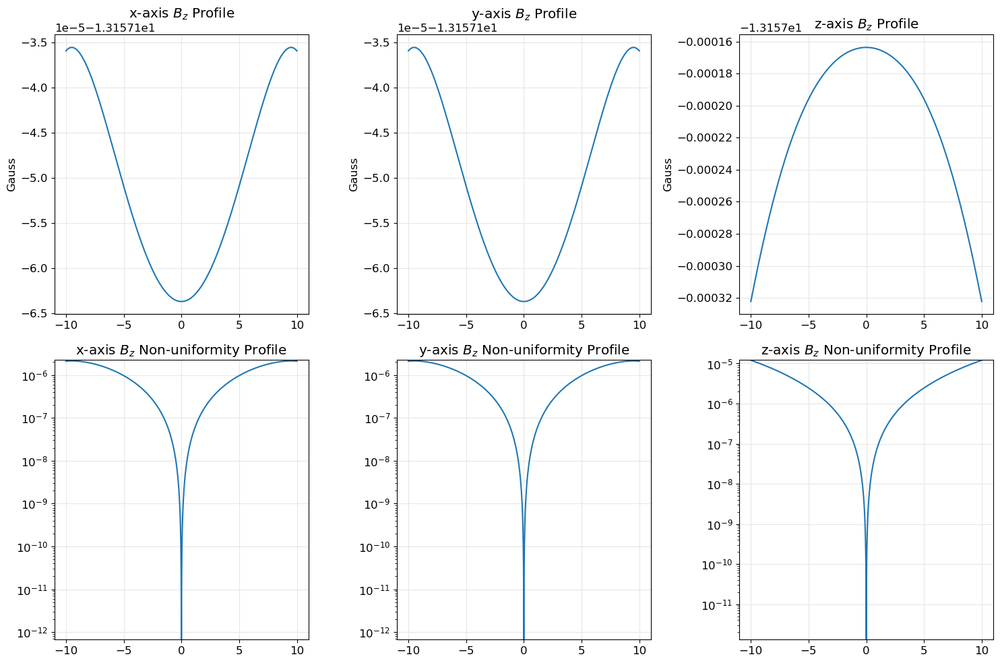

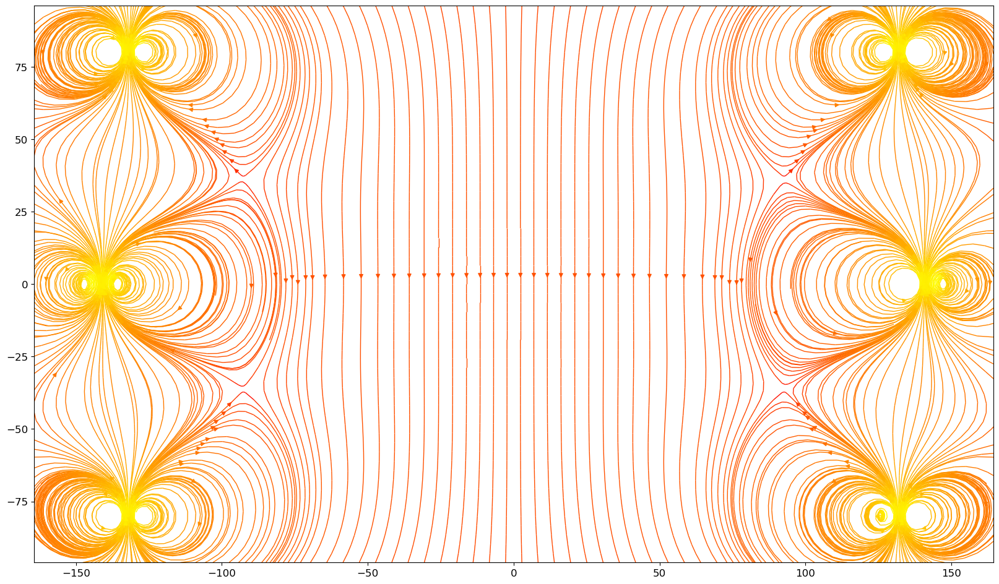

In [6]:
Br = 1.09e3
innerrad1, innerrad2, width, thickness, dist = res.x
magnets = three_rings(Br, innerrad1, innerrad2, width, thickness, dist)

sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad1, 1.2*innerrad1]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])